#**Predicting Loan Default By A Customer**

**Project Summary:** In this data science project, we will predict borrowers chance of defaulting on loans by building a default prediction model.

**Default (Banking Terminology):** The borrower unable to repay the loan

**Techniques Used**
1.   Decision Tree Classifier
2.   Random Forest Classifier
3.   Logistic Regression
4.   Support Vector Machines
5.   Artifical Neural Networks

Out of the five techniques used in this project, Artifical Neural Networks gives the highest precision of 82%.

##**Mounting Drive**

In [ ]:
from google.colab import drive
import os
drive.mount('/content/drive', force_remount=True)
os.chdir('/content/drive/MyDrive/Personal_Projects')

Mounted at /content/drive


##**Insights On The Data**

In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import sklearn as sklearn
import seaborn as sns
from scipy import stats
from sklearn.preprocessing import LabelEncoder

%matplotlib inline

In [ ]:
data = pd.read_csv("Credit_Scoring.csv")
data.head()

,Status,Seniority,Home,Time,Age,Marital,Records,Job,Expenses,Income,Assets,Debt,Amount,Price,Finrat,Savings
0,good,9,rent,60,30,married,no_rec,freelance,73,129,0,0,800,846,94.562648,4.200000
1,good,17,rent,60,58,widow,no_rec,fixed,48,131,0,0,1000,1658,60.313631,4.980000
2,bad,10,owner,36,46,married,yes_rec,freelance,90,200,3000,0,2000,2985,67.001675,1.980000
3,good,0,rent,60,24,single,no_rec,fixed,63,182,2500,0,900,1325,67.924528,7.933333
4,good,0,rent,36,26,single,no_rec,fixed,46,107,0,0,310,910,34.065934,7.083871


In [ ]:
# Dataset Dimensions
data.shape

(4446, 16)

In [ ]:
# Checking if any Missing Values are there in the Dataset
data.isnull().any()

Status       False
Seniority    False
Home         False
Time         False
Age          False
Marital      False
Records      False
Job          False
Expenses     False
Income       False
Assets       False
Debt         False
Amount       False
Price        False
Finrat       False
Savings      False
dtype: bool

In [ ]:
# Checking if any categorical Features are there in the Dataset
categorical_data = data.select_dtypes(exclude=[np.number])
print ("There are {} categorical Columns in Dataset".format(categorical_data.shape[1]))

There are 5 categorical Columns in Dataset


In [ ]:
# Name of all the Categorical Features Present in the Dataset
categorical_data.any()

Status     True
Home       True
Marital    True
Records    True
Job        True
dtype: bool

In [ ]:
model = LabelEncoder()
data['Status'] = model.fit_transform(data['Status'].astype('str'))
data['Home'] = model.fit_transform(data['Home'].astype('str'))
data['Marital'] = model.fit_transform(data['Marital'].astype('str'))
data['Job'] = model.fit_transform(data['Job'].astype('str'))
data['Records'] = model.fit_transform(data['Records'].astype('str'))

In [ ]:
#Checking Data Types of the Features for Confirmation
data.dtypes

Status         int64
Seniority      int64
Home           int64
Time           int64
Age            int64
Marital        int64
Records        int64
Job            int64
Expenses       int64
Income         int64
Assets         int64
Debt           int64
Amount         int64
Price          int64
Finrat       float64
Savings      float64
dtype: object

In [ ]:
# Summary of the Data
data.describe()

,Status,Seniority,Home,Time,Age,Marital,Records,Job,Expenses,Income,Assets,Debt,Amount,Price,Finrat,Savings
count,4446.000000,4446.000000,4446.000000,4446.000000,4446.000000,4446.000000,4446.000000,4446.000000,4446.000000,4446.000000,4446.000000,4446.000000,4446.000000,4446.000000,4446.000000,4446.000000
mean,0.719073,7.991453,2.862348,46.453441,37.084121,1.503599,0.172964,0.610886,55.601439,140.629780,5354.948943,342.257085,1038.763383,1462.480432,72.616409,3.860083
std,0.449502,8.176370,1.308943,14.647979,10.986366,0.891838,0.378259,0.960975,19.520839,80.177896,11534.328183,1244.694549,474.747952,628.555171,20.390595,3.726292
min,0.000000,0.000000,0.000000,6.000000,18.000000,0.000000,0.000000,0.000000,35.000000,1.000000,0.000000,0.000000,100.000000,105.000000,6.702413,-8.160000
25%,0.000000,2.000000,2.000000,36.000000,28.000000,1.000000,0.000000,0.000000,35.000000,90.000000,0.000000,0.000000,700.000000,1116.250000,60.030020,1.615385
50%,1.000000,5.000000,2.000000,48.000000,36.000000,1.000000,0.000000,0.000000,51.000000,124.000000,3000.000000,0.000000,1000.000000,1400.000000,77.096757,3.120000
75%,1.000000,12.000000,4.000000,60.000000,45.000000,2.000000,0.000000,1.000000,72.000000,170.000000,6000.000000,0.000000,1300.000000,1691.500000,88.460263,5.195688
max,1.000000,48.000000,5.000000,72.000000,68.000000,4.000000,1.000000,3.000000,180.000000,959.000000,300000.000000,30000.000000,5000.000000,11140.000000,100.000000,33.250000


In [ ]:
# Value Counts of 'GOOD' Status and 'BAD' Status
# 'GOOD': 1 and 'BAD': 0
data.Status.value_counts()

1    3197
0    1249
Name: Status, dtype: int64

In [ ]:
# As per the Dataset there are approximately 72% GOOD Score and 28% BAD Score instances
status_count = data.Status.value_counts()/len(data)
status_count

1    0.719073
0    0.280927
Name: Status, dtype: float64

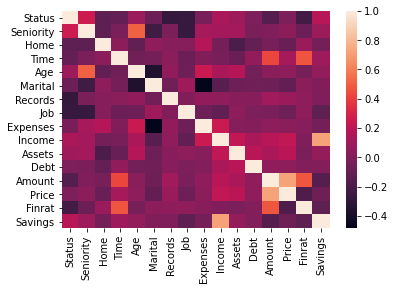

In [ ]:
# Correlation between all the Features
# Correlation heatmap
corr = data.corr()
sns.heatmap(corr)

In [ ]:
# Correlation Values of all the Features with respect to Target Variable 'Status' 
print (corr['Status'].sort_values(ascending=False), '\n')

Status       1.000000
Seniority    0.259742
Savings      0.185516
Income       0.144362
Assets       0.097239
Age          0.095305
Price       -0.010144
Debt        -0.010408
Expenses    -0.029633
Marital     -0.072958
Time        -0.101057
Home        -0.123475
Amount      -0.154325
Finrat      -0.221790
Job         -0.267701
Records     -0.277817
Name: Status, dtype: float64 



In [ ]:
## Visualising Correlation Matrix with actual Correlation Values
cmap=sns.diverging_palette(5, 250, as_cmap=True)

corr.style.background_gradient(cmap, axis=1).set_properties(**{'max-width': '80px', 'font-size': '10pt'}).set_caption("Correlation Matrix").set_precision(3)

,Status,Seniority,Home,Time,Age,Marital,Records,Job,Expenses,Income,Assets,Debt,Amount,Price,Finrat,Savings
Status,1.000,0.260,-0.123,-0.101,0.095,-0.073,-0.278,-0.268,-0.030,0.144,0.097,-0.010,-0.154,-0.010,-0.222,0.186
Seniority,0.260,1.000,-0.121,-0.022,0.506,-0.229,-0.016,-0.271,0.126,0.121,0.124,-0.019,-0.008,0.041,-0.073,0.093
Home,-0.123,-0.121,1.000,0.041,-0.108,0.052,0.020,0.016,0.176,-0.039,-0.183,-0.098,-0.032,-0.087,0.089,-0.041
Time,-0.101,-0.022,0.041,1.000,-0.052,-0.039,0.028,-0.077,-0.002,-0.030,-0.083,0.058,0.431,0.130,0.469,0.102
Age,0.095,0.506,-0.108,-0.052,1.000,-0.358,0.060,-0.061,0.248,0.148,0.181,-0.046,0.029,0.049,-0.035,0.062
Marital,-0.073,-0.229,0.052,-0.039,-0.358,1.000,-0.054,0.106,-0.484,-0.141,-0.062,-0.054,-0.072,-0.102,0.033,0.000
Records,-0.278,-0.016,0.020,0.028,0.060,-0.054,1.000,-0.000,0.058,0.053,0.021,0.023,0.111,0.085,0.051,-0.003
Job,-0.268,-0.271,0.016,-0.077,-0.061,0.106,-0.000,1.000,-0.064,-0.111,0.045,-0.010,-0.026,-0.063,0.052,-0.123
Expenses,-0.030,0.126,0.176,-0.002,0.248,-0.484,0.058,-0.064,1.000,0.255,0.019,0.015,0.050,0.041,0.025,-0.038
Income,0.144,0.121,-0.039,-0.030,0.148,-0.141,0.053,-0.111,0.255,1.000,0.219,0.145,0.191,0.218,-0.003,0.718


**Histogram Plots of all the Features in the Dataset**

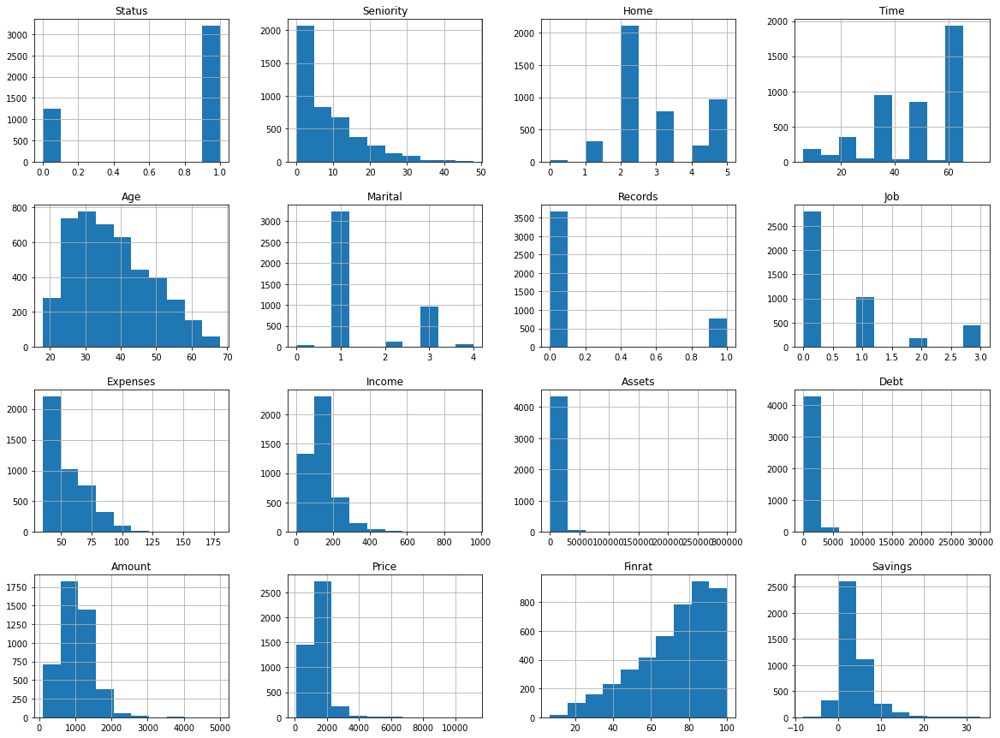

In [ ]:
num_bins = 10
data.hist(bins = num_bins, figsize=(20,15))
plt.savefig("Data_Histogram_Plots")
plt.show()

**Creating Dummy Variables**

In [ ]:
list(data.columns)

['Status',
 'Seniority',
 'Home',
 'Time',
 'Age',
 'Marital',
 'Records',
 'Job',
 'Expenses',
 'Income',
 'Assets',
 'Debt',
 'Amount',
 'Price',
 'Finrat',
 'Savings']

In [ ]:
feature_cols = list(data.columns)
feature_cols.remove('Status')
feature_cols

['Seniority',
 'Home',
 'Time',
 'Age',
 'Marital',
 'Records',
 'Job',
 'Expenses',
 'Income',
 'Assets',
 'Debt',
 'Amount',
 'Price',
 'Finrat',
 'Savings']

In [ ]:
label = data['Status']

In [ ]:
credit_data = pd.get_dummies(data[feature_cols], drop_first = True)
len(credit_data.columns)

15

##**Pre-Processing**

In [ ]:
import pandas as pd
import numpy as np
from sklearn.preprocessing import LabelEncoder, StandardScaler
from sklearn.model_selection import train_test_split

In [ ]:
data = pd.read_csv("Credit_Scoring.csv")
data.head()

,Status,Seniority,Home,Time,Age,Marital,Records,Job,Expenses,Income,Assets,Debt,Amount,Price,Finrat,Savings
0,good,9,rent,60,30,married,no_rec,freelance,73,129,0,0,800,846,94.562648,4.200000
1,good,17,rent,60,58,widow,no_rec,fixed,48,131,0,0,1000,1658,60.313631,4.980000
2,bad,10,owner,36,46,married,yes_rec,freelance,90,200,3000,0,2000,2985,67.001675,1.980000
3,good,0,rent,60,24,single,no_rec,fixed,63,182,2500,0,900,1325,67.924528,7.933333
4,good,0,rent,36,26,single,no_rec,fixed,46,107,0,0,310,910,34.065934,7.083871


In [ ]:
data.shape

(4446, 16)

In [ ]:
feature_cols = list(data.columns)
feature_cols.remove('Status')
feature_cols

['Seniority',
 'Home',
 'Time',
 'Age',
 'Marital',
 'Records',
 'Job',
 'Expenses',
 'Income',
 'Assets',
 'Debt',
 'Amount',
 'Price',
 'Finrat',
 'Savings']

In [ ]:
# Checking if any Missing Values are there in the Dataset
data.isnull().any()

Status       False
Seniority    False
Home         False
Time         False
Age          False
Marital      False
Records      False
Job          False
Expenses     False
Income       False
Assets       False
Debt         False
Amount       False
Price        False
Finrat       False
Savings      False
dtype: bool

In [ ]:
# Checking if any categorical Features are there in the Dataset
categorical_data = data.select_dtypes(exclude=[np.number])
print ("There are {} categorical Columns in Dataset".format(categorical_data.shape[1]))

There are 5 categorical Columns in Dataset


In [ ]:
# Name of all the Categorical Features Present in the Dataset
categorical_data.any()

Status     True
Home       True
Marital    True
Records    True
Job        True
dtype: bool

In [ ]:
encoder =  LabelEncoder()
data['Status'] = encoder.fit_transform(data['Status'].astype('str'))
data['Home'] = encoder.fit_transform(data['Home'].astype('str'))
data['Marital'] = encoder.fit_transform(data['Marital'].astype('str'))
data['Job'] = encoder.fit_transform(data['Job'].astype('str'))
data['Records'] = encoder.fit_transform(data['Records'].astype('str'))

In [ ]:
data.head()

,Status,Seniority,Home,Time,Age,Marital,Records,Job,Expenses,Income,Assets,Debt,Amount,Price,Finrat,Savings
0,1,9,5,60,30,1,0,1,73,129,0,0,800,846,94.562648,4.200000
1,1,17,5,60,58,4,0,0,48,131,0,0,1000,1658,60.313631,4.980000
2,0,10,2,36,46,1,1,1,90,200,3000,0,2000,2985,67.001675,1.980000
3,1,0,5,60,24,3,0,0,63,182,2500,0,900,1325,67.924528,7.933333
4,1,0,5,36,26,3,0,0,46,107,0,0,310,910,34.065934,7.083871


In [ ]:
#Checking Data Types of the Features for Confirmation
data.dtypes

Status         int64
Seniority      int64
Home           int64
Time           int64
Age            int64
Marital        int64
Records        int64
Job            int64
Expenses       int64
Income         int64
Assets         int64
Debt           int64
Amount         int64
Price          int64
Finrat       float64
Savings      float64
dtype: object

In [ ]:
# Value Counts of 'GOOD' Status and 'BAD' Status
# 'GOOD': 1 and 'BAD': 0
data.Status.value_counts()

1    3197
0    1249
Name: Status, dtype: int64

In [ ]:
X = data.iloc[:,1:].values
y = data.iloc[:,0].values
Y = pd.get_dummies(y).values

In [ ]:
print('Size')
print(f'X: {X.size}\nY: {Y.size}\ny: {y.size}\n')

print('Shape')
print(f'X: {X.shape}\nY: {Y.shape}\ny: {y.shape}\n')

Size
X: 66690
Y: 8892
y: 4446

Shape
X: (4446, 15)
Y: (4446, 2)
y: (4446,)



In [ ]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=0, shuffle=True)

In [ ]:
print('Size')
print(f'X_train: {X_train.size}\nX_test: {X_test.size}\ny_train: {y_train.size}\ny_test: {y_test.size}\ndata: {data.size}\n')

print('Shape')
print(f'X_train: {X_train.shape}\nX_test: {X_test.shape}\ny_train: {y_train.shape}\ny_test: {y_test.shape}\ndata: {data.shape}\n')

Size
X_train: 53340
X_test: 13350
y_train: 3556
y_test: 890
data: 71136

Shape
X_train: (3556, 15)
X_test: (890, 15)
y_train: (3556,)
y_test: (890,)
data: (4446, 16)



In [ ]:
# Run This Cell Only For Pre-Processing Data For Artifical Neural Networks
y_train = tf.one_hot(y_train, depth=2)
y_test = tf.one_hot(y_test, depth=2)

In [ ]:
# Run This Cell Only For Pre-Processing Data For Artifical Neural Networks
print('Size')
print(f'X_train: {X_train.size}\nX_test: {X_test.size}\ny_train: {y_train.size}\ny_test: {y_test.size}\ndata: {data.size}\n')

print('Shape')
print(f'X_train: {X_train.shape}\nX_test: {X_test.shape}\ny_train: {y_train.shape}\ny_test: {y_test.shape}\ndata: {data.shape}\n')

In [ ]:
sc = StandardScaler()
X_train = sc.fit_transform(X_train)
X_test = sc.fit_transform(X_test)

##**Decision Tree Classifier**

In [ ]:
from sklearn.metrics import classification_report, confusion_matrix, accuracy_score, average_precision_score
from sklearn.tree import DecisionTreeClassifier, export_graphviz
from sklearn import tree
from sklearn import metrics
from sklearn.tree import export_graphviz
from sklearn.externals.six import StringIO  
from IPython.display import Image  
import pydotplus
from IPython.display import display
import graphviz

**Decision Tree With Splitting Criterion As Gini**

Default: criterion = 'gini'

In [ ]:
dtc_gini = DecisionTreeClassifier()
dtc_gini = dtc_gini.fit(X_train,y_train)
y_pred = dtc_gini.predict(X_test)

In [ ]:
print(classification_report(y_test, y_pred))

              precision    recall  f1-score   support

           0       0.48      0.56      0.52       252
           1       0.81      0.76      0.79       638

    accuracy                           0.71       890
   macro avg       0.65      0.66      0.65       890
weighted avg       0.72      0.71      0.71       890



In [ ]:
confusion_matrix(y_test, y_pred)

array([[141, 111],
       [151, 487]])

In [ ]:
round(accuracy_score(y_test, y_pred), 2)

0.71

In [ ]:
round(average_precision_score(y_test, y_pred), 2)

0.79

In [ ]:
# Visualizing Decision Tree
dot_data = StringIO()
export_graphviz(dtc_gini, out_file=dot_data,  
                filled=True, rounded=True,
                special_characters=True,feature_names = feature_cols,class_names=['Good', 'Bad'])
graph = pydotplus.graph_from_dot_data(dot_data.getvalue())  
graph.write_png('DT_Gini.png')
Image(graph.create_png())

dot: graph is too large for cairo-renderer bitmaps. Scaling by 0.982813 to fit

dot: graph is too large for cairo-renderer bitmaps. Scaling by 0.982813 to fit



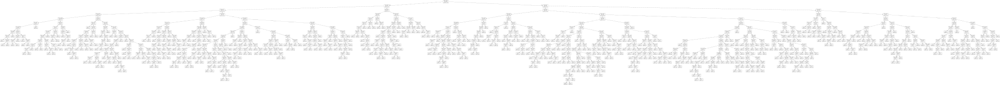

In [ ]:
display(graphviz.Source(export_graphviz(dtc_gini)))

**Decision Tree With Splitting Criterion As Entropy**

In [ ]:
dtc_entropy = DecisionTreeClassifier(criterion='entropy')
dtc_entropy = dtc_entropy.fit(X_train,y_train)
y_pred = dtc_entropy.predict(X_test)

In [ ]:
print(classification_report(y_test, y_pred))

              precision    recall  f1-score   support

           0       0.47      0.55      0.51       252
           1       0.81      0.76      0.78       638

    accuracy                           0.70       890
   macro avg       0.64      0.66      0.65       890
weighted avg       0.72      0.70      0.71       890



In [ ]:
confusion_matrix(y_test, y_pred)

array([[139, 113],
       [154, 484]])

In [ ]:
round(accuracy_score(y_test, y_pred), 2)

0.7

In [ ]:
round(average_precision_score(y_test, y_pred), 2)

0.79

In [ ]:
# Visualizing Decision Tree
dot_data = StringIO()
export_graphviz(dtc_entropy, out_file=dot_data,  
                filled=True, rounded=True,
                special_characters=True,feature_names = feature_cols,class_names=['Good', 'Bad'])
graph = pydotplus.graph_from_dot_data(dot_data.getvalue())  
graph.write_png('DT_Entropy.png')
Image(graph.create_png())

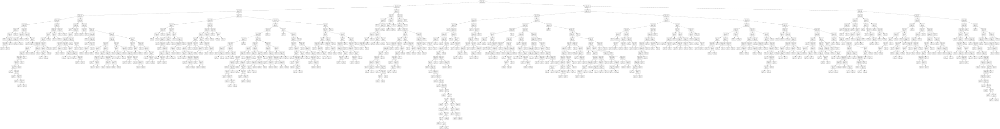

In [ ]:
display(graphviz.Source(export_graphviz(dtc_entropy)))

##**Random Forest Classifier**

In [ ]:
from sklearn.ensemble import RandomForestClassifier 
from sklearn.metrics import classification_report, confusion_matrix, accuracy_score, average_precision_score

In [ ]:
rf = RandomForestClassifier(n_estimators = 70) 
rf.fit(X_train, y_train) 
y_pred = rf.predict(X_test) 

In [ ]:
print(classification_report(y_test, y_pred))

              precision    recall  f1-score   support

           0       0.65      0.51      0.57       252
           1       0.82      0.89      0.85       638

    accuracy                           0.78       890
   macro avg       0.74      0.70      0.71       890
weighted avg       0.77      0.78      0.77       890



In [ ]:
confusion_matrix(y_test, y_pred)

array([[128, 124],
       [ 69, 569]])

In [ ]:
round(accuracy_score(y_test, y_pred), 2)

0.78

In [ ]:
round(average_precision_score(y_test, y_pred), 2)

0.81

##**Logistic Regression**

In [ ]:
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import classification_report,confusion_matrix

In [ ]:
lr = LogisticRegression(random_state=0, solver='lbfgs', max_iter=2700).fit(X_train, y_train)
print(f'Accuracy: {lr.score(X_test, y_test)}')

Accuracy: 0.8033707865168539


In [ ]:
y_pred = lr.predict(X_test)

In [ ]:
print(classification_report(y_test, y_pred))

              precision    recall  f1-score   support

           0       0.73      0.49      0.58       252
           1       0.82      0.93      0.87       638

    accuracy                           0.80       890
   macro avg       0.77      0.71      0.73       890
weighted avg       0.79      0.80      0.79       890



In [ ]:
confusion_matrix(y_test, y_pred)

array([[123, 129],
       [ 46, 592]])

In [ ]:
round(accuracy_score(y_test, y_pred), 2)

0.8

In [ ]:
round(average_precision_score(y_test, y_pred), 2)

0.81

##**Support Vector Machine**

In [ ]:
from sklearn.svm import SVC
from sklearn.svm import LinearSVC
from sklearn.linear_model import SGDClassifier
from sklearn.metrics import classification_report,confusion_matrix

**Using The SVM Classifier**

In [ ]:
svc = SVC(kernel='rbf', gamma='auto')
svc.fit(X_train, y_train) 
y_pred = svc.predict(X_test) 

In [ ]:
print(classification_report(y_test, y_pred))

              precision    recall  f1-score   support

           0       0.73      0.49      0.59       252
           1       0.82      0.93      0.87       638

    accuracy                           0.80       890
   macro avg       0.77      0.71      0.73       890
weighted avg       0.79      0.80      0.79       890



In [ ]:
confusion_matrix(y_test, y_pred)

array([[124, 128],
       [ 47, 591]])

In [ ]:
round(accuracy_score(y_test, y_pred), 2)

0.8

In [ ]:
round(average_precision_score(y_test, y_pred), 2)

0.81

**Using The SGD Classifier**

In [ ]:
sgdc = SGDClassifier(max_iter=1000, tol=1e-3)
sgdc.fit(X_train, y_train) 
y_pred = sgdc.predict(X_test) 

In [ ]:
print(classification_report(y_test, y_pred))

              precision    recall  f1-score   support

           0       0.59      0.52      0.55       252
           1       0.82      0.86      0.84       638

    accuracy                           0.76       890
   macro avg       0.71      0.69      0.70       890
weighted avg       0.76      0.76      0.76       890



In [ ]:
confusion_matrix(y_test, y_pred)

array([[131, 121],
       [ 90, 548]])

In [ ]:
round(accuracy_score(y_test, y_pred), 2)

0.76

In [ ]:
round(average_precision_score(y_test, y_pred), 2)

0.8

**Using The Linear SVC Classifier**

In [ ]:
lsvc = LinearSVC(random_state=0, tol=1e-5, max_iter=30000)
lsvc.fit(X_train, y_train) 
y_pred = lsvc.predict(X_test) 

In [ ]:
print(classification_report(y_test, y_pred))

              precision    recall  f1-score   support

           0       0.73      0.48      0.58       252
           1       0.82      0.93      0.87       638

    accuracy                           0.80       890
   macro avg       0.77      0.71      0.73       890
weighted avg       0.79      0.80      0.79       890



In [ ]:
confusion_matrix(y_test, y_pred)

array([[122, 130],
       [ 46, 592]])

In [ ]:
round(accuracy_score(y_test, y_pred), 2)

0.8

In [ ]:
round(average_precision_score(y_test, y_pred), 2)

0.81

##**Artifical Neural Networks**

In [ ]:
import keras
import tensorflow as tf
from keras.models import Sequential, Model
from keras.layers import Dense, Input
from keras.optimizers import Adam
from sklearn.metrics import classification_report, confusion_matrix, accuracy_score, average_precision_score

**Building, Training and Testing The Model**

I Build the models using the old fashioned trial and error method

Model1 seems to give the highest accuracy

In [ ]:
# Acc: 78.94
# Weights file: two_layer_credit_score_model.h5
def build_model1(weights_path=None):
  input = Input((15,))
  layer1 = Dense(30, activation='relu')(input)
  layer2 = Dense(30, activation='relu')(layer1)
  output = Dense(2, activation='softmax')(layer2)

  if not weights_path:
    model = Model(inputs=input, outputs=output)
    model.compile(optimizer="Adam", loss='binary_crossentropy', metrics=['accuracy'])
  else:
    model = Model(inputs=input, outputs=output)
    model.load_weights(weights_path)
  return model


def build_model2(weights_path=None):
  input = Input((15,))
  layer1 = Dense(30, activation='relu')(input)
  layer2 = Dense(30, activation='relu')(layer1)
  layer3 = Dense(15, activation='relu')(layer2)
  output = Dense(2, activation='softmax')(layer3)

  if not weights_path:
    model = Model(inputs=input, outputs=output)
    model.compile(optimizer="Adam", loss='binary_crossentropy', metrics=['accuracy'])
  else:
    model = Model(inputs=input, outputs=output)
    model.load_weights(weights_path)
  return model


def build_model3(weights_path=None):
  input = Input((15,))
  layer1 = Dense(30, activation='sigmoid')(input)
  layer2 = Dense(30, activation='sigmoid')(layer1)
  output = Dense(2, activation='softmax')(layer2)

  if not weights_path:
    model = Model(inputs=input, outputs=output)
    model.compile(optimizer="Adam", loss='binary_crossentropy', metrics=['accuracy'])
  else:
    model = Model(inputs=input, outputs=output)
    model.load_weights(weights_path)
  return model


def build_model4(weights_path=None):
  input = Input((15,))
  layer1 = Dense(30, activation='sigmoid')(input)
  layer2 = Dense(30, activation='sigmoid')(layer1)
  layer3 = Dense(15, activation='sigmoid')(layer2)
  output = Dense(2, activation='softmax')(layer3)

  if not weights_path:
    model = Model(inputs=input, outputs=output)
    model.compile(optimizer="Adam", loss='binary_crossentropy', metrics=['accuracy'])
  else:
    model = Model(inputs=input, outputs=output)
    model.load_weights(weights_path)
  return model


def test_model(model, X_test, y_test):
  y_pred = model.predict(X_test)
  y_test_class = np.argmax(y_test,axis=1)
  y_pred_class = np.argmax(y_pred,axis=1)

  print('Classification Report:')
  print(classification_report(y_test_class,y_pred_class))
  print('Confusion Martix:')
  print(confusion_matrix(y_test_class,y_pred_class))

In [ ]:
model = build_model1()

In [ ]:
model.summary()

Model: "model_2"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_3 (InputLayer)         [(None, 15)]              0         
_________________________________________________________________
dense_6 (Dense)              (None, 30)                480       
_________________________________________________________________
dense_7 (Dense)              (None, 30)                930       
_________________________________________________________________
dense_8 (Dense)              (None, 2)                 62        
Total params: 1,472
Trainable params: 1,472
Non-trainable params: 0
_________________________________________________________________


In [ ]:
model.fit(X_train, y_train, batch_size=10, epochs=100)

Epoch 1/100
356/356 [==============================] - 1s 1ms/step - loss: 0.5577 - accuracy: 0.7294
Epoch 2/100
356/356 [==============================] - 0s 1ms/step - loss: 0.4476 - accuracy: 0.7935
Epoch 3/100
356/356 [==============================] - 0s 1ms/step - loss: 0.4626 - accuracy: 0.7778
Epoch 4/100
356/356 [==============================] - 0s 1ms/step - loss: 0.4455 - accuracy: 0.7815
Epoch 5/100
356/356 [==============================] - 0s 1ms/step - loss: 0.4227 - accuracy: 0.8031
Epoch 6/100
356/356 [==============================] - 0s 1ms/step - loss: 0.4238 - accuracy: 0.8076
Epoch 7/100
356/356 [==============================] - 0s 1ms/step - loss: 0.4026 - accuracy: 0.8114
Epoch 8/100
356/356 [==============================] - 0s 1ms/step - loss: 0.4131 - accuracy: 0.8010
Epoch 9/100
356/356 [==============================] - 0s 1ms/step - loss: 0.3972 - accuracy: 0.8120
Epoch 10/100
356/356 [==============================] - 0s 1ms/step - loss: 0.4077 - accura

In [ ]:
model.save_weights("two_layer_credit_score_model.h5")

In [ ]:
y_pred = model.predict(X_test)
y_test_class = np.argmax(y_test,axis=1)
y_pred_class = np.argmax(y_pred,axis=1)

In [ ]:
print(classification_report(y_test_class,y_pred_class))

              precision    recall  f1-score   support

           0       0.60      0.59      0.59       252
           1       0.84      0.85      0.84       638

    accuracy                           0.77       890
   macro avg       0.72      0.72      0.72       890
weighted avg       0.77      0.77      0.77       890



In [ ]:
print(confusion_matrix(y_test_class,y_pred_class))

[[148 104]
 [ 98 540]]


In [ ]:
round(average_precision_score(y_test_class,y_pred_class), 2)

0.82

In [ ]:
round(accuracy_score(y_test_class,y_pred_class), 2)

0.77